<a href="https://colab.research.google.com/github/NathanTorquato/Trilha-de-Data-Science---Centro-de-Carreira-da-Poli/blob/main/2_1_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <center> Análise Exploratória de Dados - Teoria e Exercícios </center>


<a id="intro"></a>
## 1. Introdução
Na aula anterior abordamos alguns conceitos iniciais sobre ML e fizemos uma introdução a algumas das principais bibliotecas para se trabalhar com Ciência de Dados no Python. Nesta aula, o principal objetivo será apresentar ferramentas e métodos para a realização de uma Análise Exploratória de Dados.

O principal objetivo da etapa Análise Exploratória de Dados (ou EDA) é coletar informações relevantes e esclarecedoras para que você possa extrair valor dos dados.

A EDA é um procedimento iterativo no qual você precisa interpelar os seus dados com algumas perguntas que podem levar a informações valiosas. No entanto, ao indagar seus dados, você acaba entendendo melhor o que está acontecendo e, eventualmente, pode fazer algo valioso com essas novas informações.

Vamos agora procurar alguns *insights* dos conjuntos de dados com que trabalharemos nesta aula.

### Base de dados: Iris

[Download Base Dados](https://drive.google.com/file/d/1kN_x2aOL6elO_6e6PX7uaYxP4LdQwk5d/view?usp=sharing)

Este é provavelmente um dos conjuntos de dados *training wheels* mais conhecidos. É um conjunto de dados simples e pequeno, comumente usado pela comunidade de ciência de dados como exemplo para a aplicação de algumas técnicas.

Aqui podemos ver quatro características (comprimento e largura da sépala, comprimento da pétala e largura da pétala) para determinar se uma flor é *setosa*, *versicolor* ou *virginica*.

<center><img src="https://cdn-images-1.medium.com/freeze/max/1000/1*gwmXliaxIBkY4NQBhoe9JQ.png?q=20" width="600">


### Base de dados: Real Estate

[Download Base Dados](https://drive.google.com/file/d/1AUsMKNPY9wTyscGvNjBE8PGMBMBpLAIh/view?usp=sharing)

Este conjunto de dados será utilizado nesta aula como um exercício em que você poderá aplicar o conhecimento das etapas anteriores. Ao contrário do conjunto de dados `` iris``, aqui você encontrará valores ausentes, outliers e outras inconsistências.

Ao longo deste caderno, você será solicitado a realizar algumas análises para extrair informações valiosas desse conjunto de dados "mais realista", que contém informações sobre propriedades vendidas por uma agência imobiliária.

<center><img src="https://miro.medium.com/max/700/1*-Ly3zdgfNiyrz8RShv9rEA.jpeg" width="300">

<a id="sum"></a>
## 2. Resumindo Dados


Quando se deseja medir algo, geralmente é necessário fazer várias medições. Isso ocorre porque geralmente as variáveis usadas para descrever comportamentos têm caráter variável. 

Assim, são necessários vários resultados para se ter uma ideia da situação. Recolhidas essas medidas, é necessário [resumi-las](https://pt.wikipedia.org/wiki/S%C3%ADntese_estat%C3%ADstica) de alguma forma, pois conjuntos contendo dados brutos não são facilmente interpretáveis. 

Portanto, antes de plotar e analisar qualquer coisa, é crucial entender o conjunto de dados com o qual você está trabalhando.

Para fazer isso, algumas informações importantes que devemos procurar são:
1. Dimensão dos dados
2. Tipo dos dados de cada variável (datatype)
3. Estatísticas do conjunto de dados (média, mediana, moda)
4. Valores nulos

Portanto, antes de obter qualquer *insight*, você precisa primeiro examinar seu conjunto de dados.

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Puxando a base 
iris = pd.read_csv('/content/drive/My Drive/Trilha DS/Aula 2 - EDA e Aprendizado não Supervisionado/Dados 2.1. EDA/Iris.csv') # a base Iris agora é um dataframe Pandas

iris.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   sepal_length  150 non-null    float64
 1   sepal_width   150 non-null    float64
 2   petal_length  150 non-null    float64
 3   petal_width   150 non-null    float64
 4   species       150 non-null    object 
dtypes: float64(4), object(1)
memory usage: 6.0+ KB


In [ ]:
# Explorando os dados
iris.head()

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa


In [ ]:
# Dimensões do dataframe
iris.shape

(150, 5)

In [ ]:
# Estatísticas da base (média, mediana, moda, desvio padrão)
iris.describe()

,sepal_length,sepal_width,petal_length,petal_width
count,150.000000,150.000000,150.000000,150.000000
mean,5.843333,3.054000,3.758667,1.198667
std,0.828066,0.433594,1.764420,0.763161
min,4.300000,2.000000,1.000000,0.100000
25%,5.100000,2.800000,1.600000,0.300000
50%,5.800000,3.000000,4.350000,1.300000
75%,6.400000,3.300000,5.100000,1.800000
max,7.900000,4.400000,6.900000,2.500000


In [ ]:
# verificando se existe algum valor nulo na base
iris.isnull().sum()

sepal_length    0
sepal_width     0
petal_length    0
petal_width     0
species         0
dtype: int64

### Exercicio 1

Carregue a base ```real_estate``` e dê uma olhada nos dados usando as funções acima.

In [ ]:
# 0. Puxar a base
real_estate = pd.read_csv('/content/drive/My Drive/Trilha DS/Aula 2 - EDA e Aprendizado não Supervisionado/Dados 2.1. EDA/real_estate.csv',
                          sep=";"
                          )

In [ ]:
# 1. Dimensões do dataframe
real_estate.shape

(1852, 14)

In [ ]:
# 2. Datatype de cada variável
real_estate.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1852 entries, 0 to 1851
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   DateSold         1852 non-null   object 
 1   SaleValue        1852 non-null   object 
 2   CommissionValue  1848 non-null   object 
 3   Area             1199 non-null   object 
 4   PropertyValue    1116 non-null   float64
 5   MunicipalTax     1027 non-null   object 
 6   RegisterDate     1852 non-null   object 
 7   Dorms            1167 non-null   float64
 8   Photos           1277 non-null   float64
 9   Baths            1170 non-null   object 
 10  Sun              874 non-null    object 
 11  Suites           712 non-null    float64
 12  Parking          1007 non-null   object 
 13  Type             1852 non-null   object 
dtypes: float64(4), object(10)
memory usage: 202.7+ KB


In [ ]:
# 3. Estatísticas da base (média, mediana, moda, desvio padrão)
real_estate.describe()

,PropertyValue,Dorms,Photos,Suites
count,1.116000e+03,1167.000000,1277.000000,712.000000
mean,6.557138e+05,2.265638,16.835552,0.793539
std,6.455706e+05,0.845558,10.775184,0.688105
min,0.000000e+00,0.000000,0.000000,0.000000
25%,2.887500e+05,2.000000,15.000000,0.000000
50%,4.500000e+05,2.000000,19.000000,1.000000
75%,7.900000e+05,3.000000,22.000000,1.000000
max,6.900000e+06,6.000000,73.000000,4.000000


In [ ]:
# 4. Valores nulos
real_estate.isnull().sum()

DateSold              0
SaleValue             0
CommissionValue       4
Area                653
PropertyValue       736
MunicipalTax        825
RegisterDate          0
Dorms               685
Photos              575
Baths               682
Sun                 978
Suites             1140
Parking             845
Type                  0
dtype: int64

<a id="dat"></a>
## 3. Visualização de Dados

Agora que temos uma ideia do que são nossos dados, podemos começar a explorá-los. Para isso, a maneira mais fácil e elegante é a visualização a partir de *plots*. Talvez vocês tenham visto alguns *plots* em aulas anteriores, mas agora vamos nos aprofundar.

Para isso, mostraremos alguns gráficos, juntamente com seu uso e código, em análises univariadas e multivariadas.

### 3.1 Análise Univariada
Os gráficos univariados são usados para entender como cada variável se comporta independentemente das outras. Alguns exemplos são *boxplots*, histogramas e gráficos de barras.

#### 3.1.1 Boxplot
Boxplots são usados para ver a distribuição de uma variável, sendo adequado para variáveis numéricas, mostrando informações como a mediana, quartis e até outliers! Basta usar ```plot``` com o argumento ```kind = 'box'```. Também adicionamos os argumentos ```figsize```, ```subplots``` e ```layout``` para ajustá-los como quisermos. Vamos brincar com esses parâmetros para ver como eles funcionam!

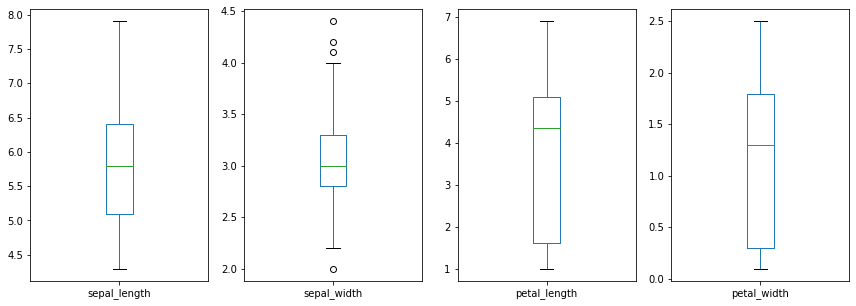

<Figure size 432x288 with 0 Axes>

In [ ]:
iris.plot(kind='box', figsize=(30, 5), subplots=True, layout=(1, 8))
_ = plt.figure()
plt.show()

#### 3.1.2. Histogramas
Histogramas são uma ferramenta de visualização da distribuição de variáveis numéricas. São criados diferentes subintervalos de valores para a variável, cada uma com uma quantidade específica de dados. Assim conseguimos ter uma boa noção da distribuição de seus valores. 

Plotaremos abaixo o histograma de forma a analisar todas as variáveis de uma vez:

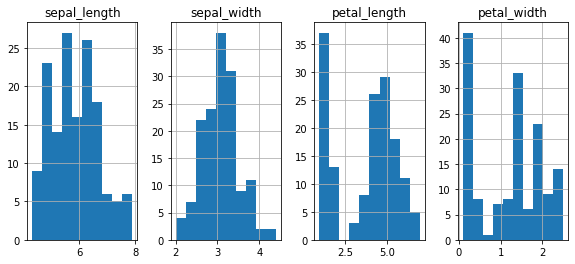

<Figure size 432x288 with 0 Axes>

In [ ]:
iris.hist(figsize=(20,4), layout=(1,8))
plt.figure()
plt.show()

#### 3.1.3. Estimativa de Densidade Kernel (KDE)
A Estimativa de densidade kernel, KDE, tenta estimar a função densidade de probabilidade de uma variável. Isso é feito ao desenhar uma curva contínua (o kernel, geralmente uma gaussiana) para cada ponto de dados. Todas as curvas são somadas para formar uma única estimativa de densidade suave.


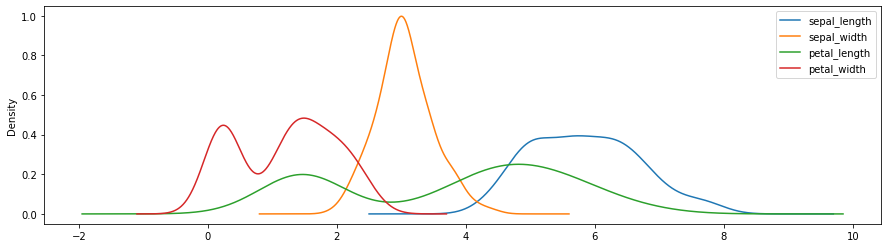

<Figure size 432x288 with 0 Axes>

In [ ]:
iris.plot(kind='kde', figsize=(15, 4), subplots=False, layout=(1, 8))
plt.figure()
plt.show()

#### 3.1.4. Gráficos de Barras
Os gráficos de barras são muito úteis quando queremos comparar valores ou verificar a distribuição de valores em categorias (pense no histograma, por exemplo). Vamos dar uma olhada na distribuição de nossa variável ```species``` usando gráficos de barras.

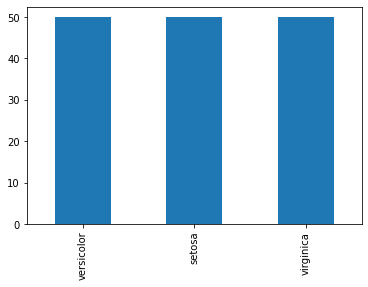

In [ ]:
iris['species'].value_counts().plot(kind="bar")
plt.show()

Três barras idênticas! Isso ocorre porque nossos dados estão igualmente distribuídos entre essas três espécies, cinquenta registros para cada.

### 3.2. Análise Multivariada
Uma vez feitos os gráficos das análises univariadas, devemos ter um bom entendimento de como cada variável age por si mesma. Mas, ao fazer ciência de dados, geralmente queremos entender como uma variável se relaciona com outra. Por exemplo, a temperatura influencia a quantidade de sorvete consumido na praia? Se isso acontecer, como isso influencia o trabalho de quem vende sorvete na praia? O consumo de sorvete cresce assim como a temperatura? Ele cresce na proporção de 1:1?

Todos esses tipos de perguntas são respondidas com análise multivariável, o que pode ser feito com gráficos multivariáveis. Vamos dar uma olhada em alguns deles.

#### 3.2.1. Gráfico de dispersão
O gráfico de dispersão mostra cada registro como um ponto no gráfico, tendo um eixo para cada variável. Por exemplo, poderíamos perguntar como o comprimento da sépala se relaciona com a largura da sépala.

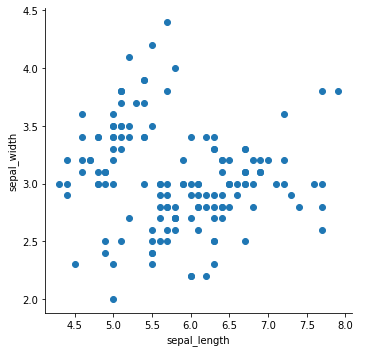

In [ ]:
# em algumas versões do python size pode ter virado height
sns.FacetGrid(iris, height = 5) \
   .map(plt.scatter, "sepal_length", "sepal_width") \
   .add_legend()
plt.show()

Aparentemente, não há correlação óbvia entre altura e largura da sépala. Mas e se pudéssemos adicionar outra informação, como as espécies? Como cada ponto no gráfico é um registro e cada registro é relacionado a uma espécie, podemos colori-los correspondentemente, adicionando outra informação ao nosso gráfico.

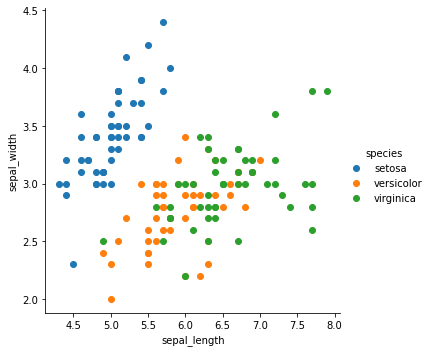

In [ ]:
sns.FacetGrid(iris, hue="species", height=5) \
   .map(plt.scatter, "sepal_length", "sepal_width") \
   .add_legend()
plt.show()

Você pode ver a diferença? Agora podemos ver claramente que Setosas são diferentes das outras em termos de correlação entre altura e largura da sépala. Isso torna possível discernir quase completamente essas espécies das outras com um limite de linha reta.

No entanto, separar Versicolor de Viginica é muito mais difícil, pois elas têm uma sobreposição considerável.

#### 3.2.2. Boxplot
Espere, não acabamos de ver o boxplot como boxplot como um gráfico univariável? Você está totalmente certo! Um boxplot é, de fato, um gráfico que mostra apenas um tipo de informação. Mas podemos ver as relações entre uma variável numérica e uma categórica usando diversos boxplots, um para cada categoria, plotando os dados numéricos. Podemos tentar visualizar o comprimento da pétala para cada espécie com isso.

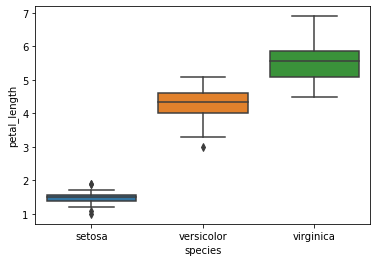

In [ ]:
sns.boxplot(x="species", y="petal_length", data=iris)
plt.show()

Isso deixa mais claro que as espécies diferem em termos de comprimento das pétalas, o que é mais verdade para as Setosas do que para Versicolor e a Virginica.

#### 3.2.3. Estimativa de Densidade Kernel (KDE)
Mais uma vez, um tipo de gráfico que apresentamos anteriormente para análise univariada. Assim como fizemos com os boxplots, podemos combinar o KDE com as espécies para ver como elas se contrastam. Essa é a vantagem sobre os histogramas sobre os quais falamos anteriormente. Imagine ter que comparar barras sobrepostas de diferentes histogramas. Isso não seria fácil. Em vez disso, usamos o KDE, que é próximo a um histograma, mas pode ser sobreposto, pois é apenas uma linha.

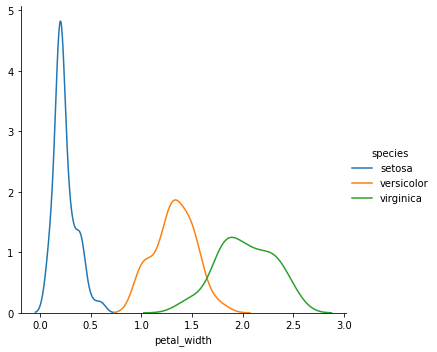

In [ ]:
sns.FacetGrid(iris, hue="species", height=5).map(sns.kdeplot, "petal_width").add_legend()
plt.show()

#### 3.2.4. Plot matrix

A biblioteca ```pandas``` facilita a análise multivariável de todas as variáveis, duas a duas. É o que chamamos de *plot matrix*. Por exemplo, poderíamos usar pandas para produzir um gráfico de dispersão para cada par de variáveis, como mostrado abaixo.



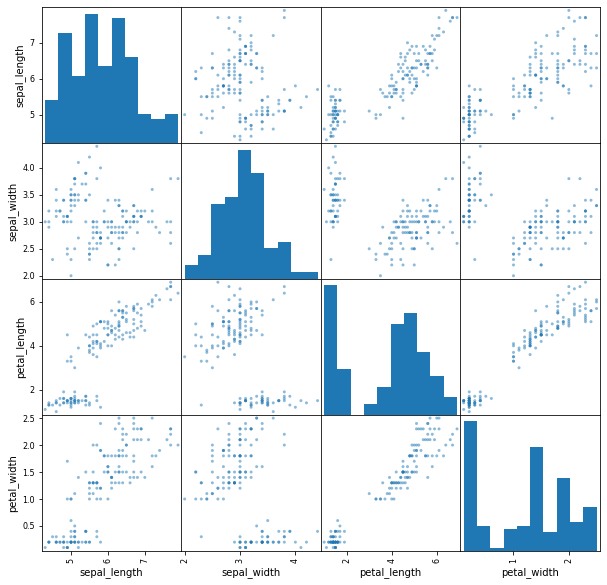

<Figure size 432x288 with 0 Axes>

In [ ]:
pd.plotting.scatter_matrix(iris, figsize=(10,10))
plt.figure()
plt.show()

Esse é um belo gráfico! Podemos analisar todos os pares de variáveis de uma só vez. Por exemplo, podemos ver que ```petal_length```, e ```petal_width```, parecem altamente correlacionados, enquanto ```sepal_length```, e ```sepal_length```, e ```sepal_width```, não.

Mas podemos melhorar isso ainda mais com a biblioteca *seaborn*! Ela permite atribuir cores às espécies e alterar o gráfico de variável única. Veja o exemplo abaixo.

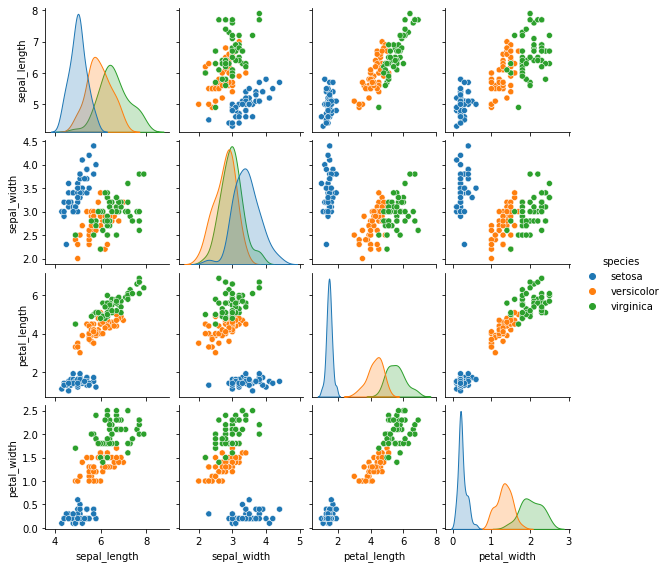

In [ ]:
_ = sns.pairplot(iris, hue="species", height=2, diag_kind="kde")
plt.show()

Podemos ver que Setosa se comporta de maneira diferente para todos os pares de variáveis, o que significa que seria possível isolá-los das outras espécies usando qualquer par de variáveis. Isso não pode ser dito para Versicolor e Virginica, especialmente para o par de variáveis altura e largura da sépala.

#### 3.2.5. Mapa de Calor de Correlação
Os mapas de calor de correlação também são conhecidos como matriz de correlação. Eles representam a correlação para cada par de variáveis, facilitando a visualização de todas as relações existentes entre as variáveis.

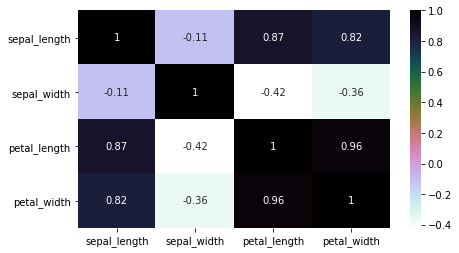

In [ ]:
plt.figure(figsize=(7,4)) 
sns.heatmap(iris.corr(),annot=True,cmap='cubehelix_r')
plt.show()

Já tínhamos uma boa visão geral dessas correlações dos gráficos anteriores, mas agora podemos confirmar que a altura e a largura da sépala quase não estão correlacionadas, enquanto a altura e a largura da pétala estão quase perfeitamente correlacionadas.

##### Insights
* ```petal_length``` e ```petal_width``` são as variáveis mais importantes para identificar vários tipos de flores.

* Embora a Setosa possa ser facilmente identificada (linearmente separável), Virginica e Versicolor mostram alguma sobreposição (maior dificuldade de separação com uma linha).

### Exercicio 2


#### Parte 1


*Nota: Nos exercícios a seguir (e na vida real), pode ser necessário verificar a documentação dos pacotes apresentados acima ou fontes externas, como [StackOverflow](https://stackoverflow.com/).*

Com o conjunto de dados ```real_estate```, plote alguns gráficos para obter algumas informações dos dados.

Quais são as principais conclusões a que podemos chegar nesta análise inicial?

Sinta-se livre para adicionar novas células, se necessário.

In [ ]:
#A primeira coisa a fazer é alterar os tipos de dados de algumas colunas
#para que consigamos representar seus valores numéricos graficamente
colunas_numericas = ['SaleValue','CommissionValue','Area','MunicipalTax']

for coluna in colunas_numericas:
  real_estate[coluna] = real_estate[coluna].str.replace(',','.').astype(np.float64)

In [ ]:
#Nas colunas Baths e Parking, nós teremos que transformar o valor 8+ para 8
#Todavia, isso afeta muitos poucos registros, de modo que não influenciará nenhuma estatística de nosso dataset
colunas_numericas2 = ['Baths', 'Parking']

for coluna in colunas_numericas2:
  real_estate[coluna] = real_estate[coluna].str.replace('+', '').astype(np.float64)

Abaixo vemos os *scatter plots* das variáveis numéricas da tabela ```real_estate```, além dos histogramas dessas variáveis.  
Percebe-se que alguns desses gráficos foram afetados negativamente por *outliers*, como os da variável Área.

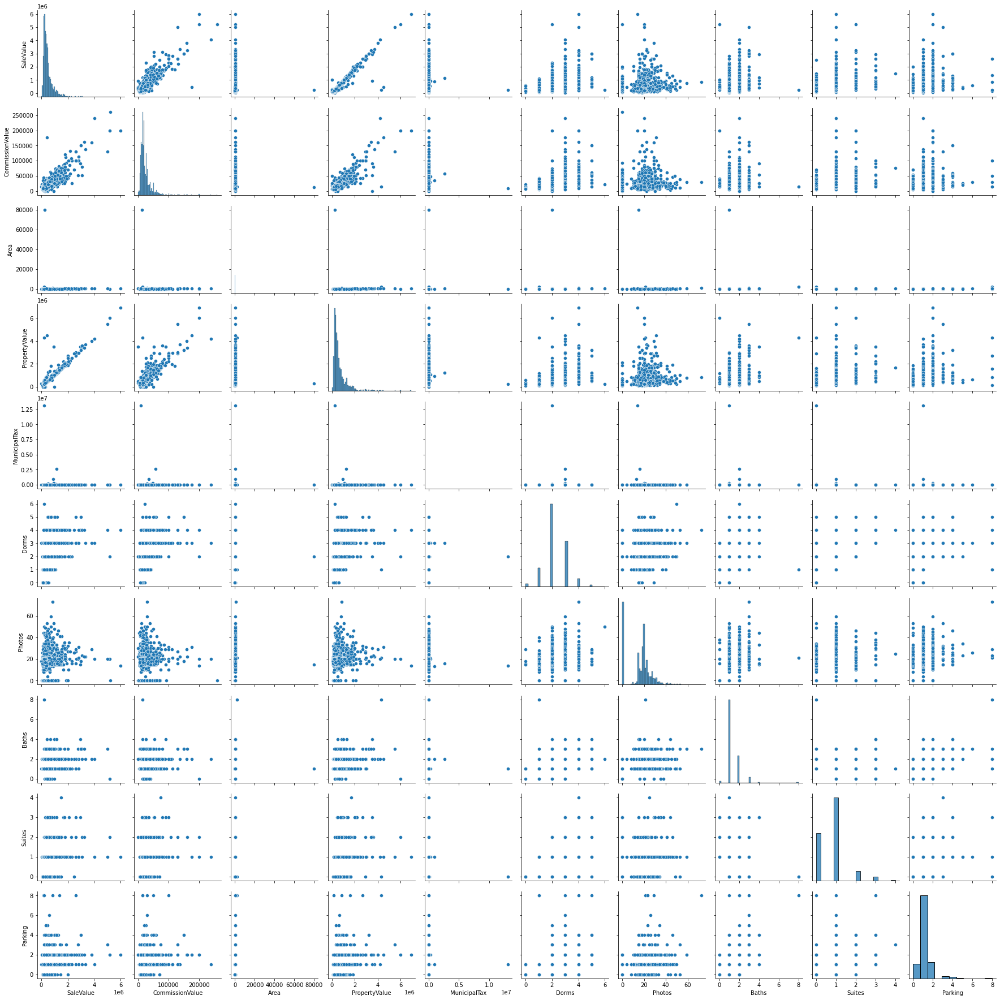

In [ ]:
sns.pairplot(real_estate);

Vemos no *heatmap* abaixo que não há grande correlação entre as variáveis, exceto aquelas associadas ao preço das propriedades (*SaleValue*, *CommissionValue* e *PropertyValue*).  
Também há uma correlação moderada/fraca entre o preço do imóvel e o número de dormitórios, suítes e banheiros.
Por fim, há uma curiosa correlação entre o número de vagas para veículos e a área das propriedades.

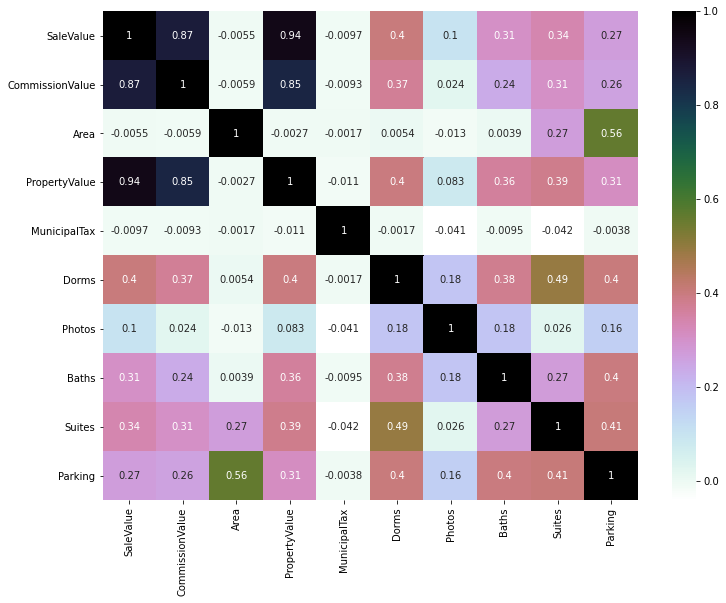

In [ ]:
plt.figure(figsize = (12,9))
sns.heatmap(real_estate.corr(), annot=True, cmap='cubehelix_r')
plt.show()

O gráfico abaixo mostra que as propriedades em revenda tem preço médio maior que as propriedades novas.

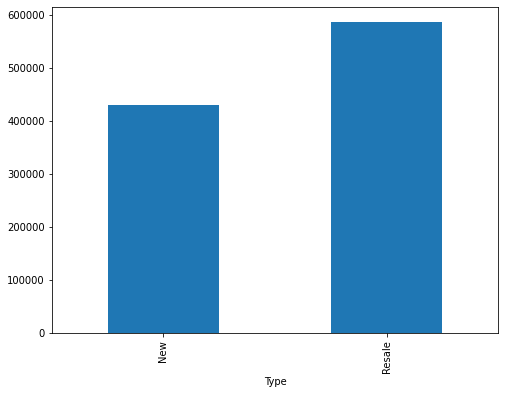

In [ ]:
real_estate.groupby('Type')['SaleValue'].mean().plot(kind='bar', figsize = (8,6));

Todavia, a área das propriedades em revenda é bem maior que a área das novas propriedades:

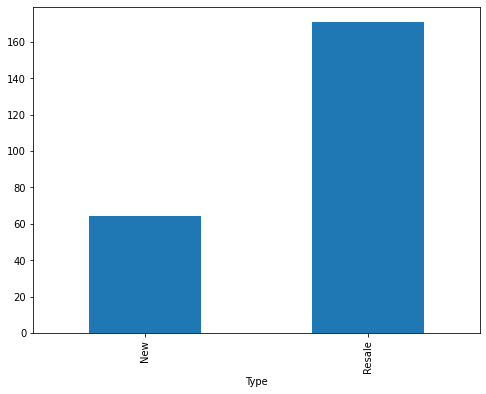

In [ ]:
real_estate.groupby('Type')['Area'].mean().plot(kind='bar', figsize = (8,6));

Assim, vale a pena criar uma nova *feature* para considerar o preço por área:

In [ ]:
real_estate['ValuePerArea'] = real_estate['SaleValue'] / real_estate['Area']
real_estate = real_estate.replace([np.inf, -np.inf], np.nan)
real_estate.head()

,DateSold,SaleValue,CommissionValue,Area,PropertyValue,MunicipalTax,RegisterDate,Dorms,Photos,Baths,Sun,Suites,Parking,Type,ValuePerArea
0,11/09/2015 14:10,590000.0,29500.00,366.00,650000.0,3352.00,24/10/2013 17:18,3.0,26.0,3.0,Morning,1.0,6.0,Resale,1612.021858
1,26/06/2015 13:34,470000.0,10420.00,38.00,490000.0,206.00,22/05/2015 18:13,1.0,11.0,1.0,Morning,0.0,NaN,Resale,12368.421053
2,31/03/2015 16:54,435000.0,24947.25,NaN,NaN,NaN,21/11/2012 18:13,NaN,0.0,NaN,NaN,NaN,NaN,New,NaN
3,31/03/2015 15:58,485000.0,20976.25,72.26,NaN,NaN,19/03/2015 14:20,3.0,NaN,1.0,NaN,1.0,1.0,New,6711.873789
4,14/08/2015 10:29,380000.0,7815.00,73.00,415000.0,687.27,10/06/2014 17:20,3.0,23.0,1.0,Afternoon,NaN,1.0,Resale,5205.479452


Plotemos um gráfico para entender qual tipo de propriedade é mais valorizada.

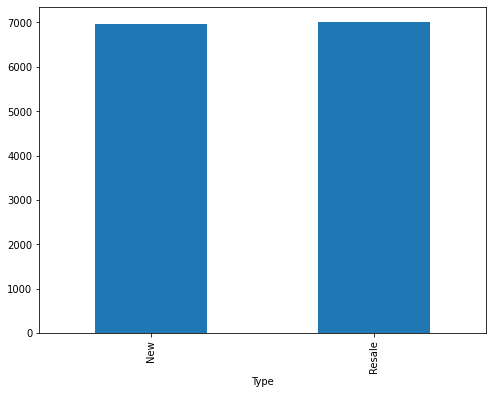

In [ ]:
real_estate.groupby('Type')['ValuePerArea'].mean().plot(kind = 'bar', figsize = (8,6));

Finalmente conseguimos tirar uma conclusão: a *feature* *Type* não influencia no preço de venda do imóvel. O preço por área é praticamente o mesmo, independentemente do *Type* da propriedade.

Por fim, para concluirmos esta primeira etapa, vemos que as propriedades sem incidência de Sol têm um valor por área consideravelmente inferior em comparação às outras.

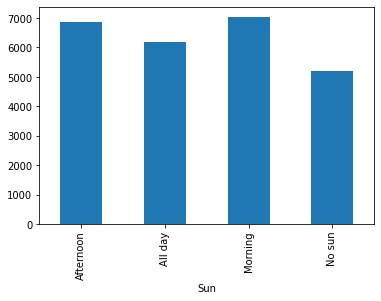

In [ ]:
real_estate.groupby('Sun')['ValuePerArea'].mean().plot(kind='bar');

Depois de trabalhar um pouco com os dados, tente responder às perguntas abaixo. Lembre-se que são perguntas abertas, portanto, é fundamental explicar sua resposta e justificá-la com análises

#### Parte 2
Qual é a faixa de preço em que esta agência imobiliária é especializada?

*dica: use histogramas e ajuste os eixos para melhor visualização*

**Resposta:** A partir do resumo estatístico das *features* *SaleValue* e *PropertyValue*, vemos que o valor médio das propriedades transacionadas por esta agência imobiliária é de 523,3 mil considerando o valor da venda ou 645,6 mil considerando o valor da propriedade.  
Os histogramas abaixo, além da comparação entre os desvios padrão revelam também que a variável *PropertyValue* é mais distribuída no intervalo de valores, isto é, tem maior variabilidade (e, consequentemente, maior desvio padrão).


In [ ]:
real_estate[['SaleValue', 'PropertyValue']].describe()

,SaleValue,PropertyValue
count,1.852000e+03,1.116000e+03
mean,5.233209e+05,6.557138e+05
std,4.840936e+05,6.455706e+05
min,7.815000e+03,0.000000e+00
25%,2.500000e+05,2.887500e+05
50%,3.900000e+05,4.500000e+05
75%,6.000000e+05,7.900000e+05
max,6.000000e+06,6.900000e+06


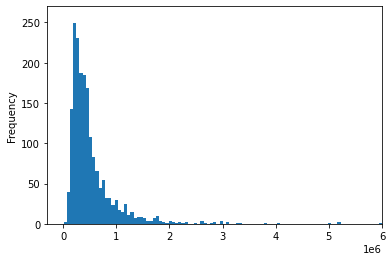

In [ ]:
real_estate['SaleValue'].plot(kind='hist', bins = 100, xlim=(-300000, 6000000), ylim=(0, 270));

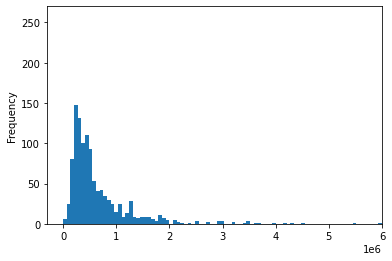

In [ ]:
real_estate['PropertyValue'].plot(kind='hist', bins = 100, xlim=(-300000, 6000000), ylim=(0, 270));

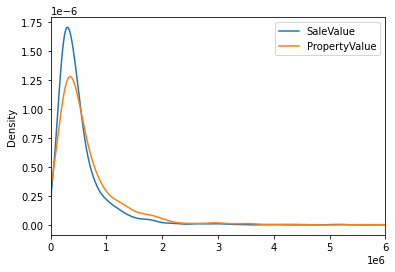

In [ ]:
real_estate[['SaleValue', 'PropertyValue']].plot(kind='kde', xlim=(0, 6000000));

#### Parte 3

A área da empresa responsável pelo faturamento dos clientes está trabalhando horas extras no final do mês, isso é justificado?

*dica: use o pacote* ```datetime``` *para lidar com datas*

**Resposta:** Podemos ver no resumo estatístico abaixo que parte considerável das vendas é realizada no final do mês (após realizar *feature engineering* com as colunas de data):
* 25% das vendas são realizadas após o dia 27, isto é, nos três ou quatro últimos dias do mês; e
* 50% das vendas são realizadas após o dia 21, ou seja, nos últimos dez dias do mês.  

Logo, o volume de trabalho na área da empresa responsável pelo faturamento dos clientes parece ser particularmente grande no final do mês. Dessa maneira, parece ser justificado eles realizarem horas extras nesse período.

In [ ]:
import datetime

In [ ]:
#Criando novas features sem a informação da hora em que a transação foi realizada e registrada
real_estate['DateSoldNew'] = real_estate['DateSold'].str.slice(stop=10)
real_estate['RegisterDateNew'] = real_estate['RegisterDate'].str.slice(stop=10)
real_estate['DaySold'] = real_estate['DateSold'].str.slice(stop=2).astype(np.int64)

real_estate[['DateSoldNew', 'RegisterDateNew', 'DaySold']].head()

,DateSoldNew,RegisterDateNew,DaySold
0,11/09/2015,24/10/2013,11
1,26/06/2015,22/05/2015,26
2,31/03/2015,21/11/2012,31
3,31/03/2015,19/03/2015,31
4,14/08/2015,10/06/2014,14


In [ ]:
#Resumo estatístico do dia de venda
real_estate[['DateSoldNew', 'RegisterDateNew', 'DaySold']].describe()

,DaySold
count,1852.000000
mean,19.269438
std,8.851392
min,1.000000
25%,12.000000
50%,21.000000
75%,27.000000
max,31.000000


In [ ]:
#Dias mais comuns de venda
real_estate['DaySold'].value_counts().head(10)

30    162
29    109
31    104
27     98
24     93
10     75
28     74
9      69
23     67
25     66
Name: DaySold, dtype: int64

#### Parte 4
A Real Estate Association pede 5% de comissão em cada negócio. Essa porcentagem está sendo respeitada em todos os tipos de propriedade?

*dica: você pode criar uma nova coluna calculada para ajudar a realizar a análise*

**Resposta:** Podemos ver abaixo que, na média, a comissão é maior que os 5% estipulados pela Real Estate Association.
Porém, há 965 propriedades onde a comissão é menor que 5%. Dentre elas, 61,55% são propriedades do *Type* *Resale* e 38,45% são *New*.

In [ ]:
#Criando variável com a porcentagem de comissão
real_estate['ComissionPorcentage'] = real_estate['CommissionValue']/real_estate['SaleValue'] * 100
real_estate[['ComissionPorcentage']].head()

,ComissionPorcentage
0,5.000000
1,2.217021
2,5.735000
3,4.325000
4,2.056579


In [ ]:
#Na média, a comissão é maior que 5% para todos os tipos de propriedade
real_estate.groupby('Type')['ComissionPorcentage'].mean()

Type
New       5.107220
Resale    5.042828
Name: ComissionPorcentage, dtype: float64

In [ ]:
#Porém, há muitos casos onde a comissão é menor que o valor estipulado de 5%
real_estate[real_estate['ComissionPorcentage'] < 5].groupby('Type')['ComissionPorcentage'].count()

Type
New       371
Resale    594
Name: ComissionPorcentage, dtype: int64

In [ ]:
#61,55% das propriedades cujo valor de comissão ficou inferior ao estipulado são 'Resale' 
real_estate[real_estate['ComissionPorcentage'] < 5]['Type'].value_counts(normalize=True)

Resale    0.615544
New       0.384456
Name: Type, dtype: float64

#### Parte 5
Quanto tempo se leva, em média, para vender uma propriedade?

*dica: calcule a média, mediana e plote a distribuição*

**Resposta:** A mediana do tempo para vender uma propriedade é 95 dias. Este valor é mais apropriado para análise, pois há *outliers* distorcendo a média, que é de 240 dias para venda.  
Se expurgamos o principal *outlier*, uma propriedade cuja data de registro é 01/01/1900, a média diminui para 217 dias.

In [ ]:
#Convertendo datas de object para datetime
real_estate['DateSoldNew'] = pd.to_datetime(real_estate["DateSoldNew"], format = '%d/%m/%Y') 
real_estate['RegisterDateNew'] = pd.to_datetime(real_estate['RegisterDateNew'], format = '%d/%m/%Y')

In [ ]:
#Verificando que funcionou
real_estate.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1852 entries, 0 to 1851
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   DateSold             1852 non-null   object        
 1   SaleValue            1852 non-null   float64       
 2   CommissionValue      1848 non-null   float64       
 3   Area                 1199 non-null   float64       
 4   PropertyValue        1116 non-null   float64       
 5   MunicipalTax         1027 non-null   float64       
 6   RegisterDate         1852 non-null   object        
 7   Dorms                1167 non-null   float64       
 8   Photos               1277 non-null   float64       
 9   Baths                1170 non-null   float64       
 10  Sun                  874 non-null    object        
 11  Suites               712 non-null    float64       
 12  Parking              1007 non-null   float64       
 13  Type                 1852 non-nul

In [ ]:
#Criando coluna no DataFrame com o número de dias entre o registro na imobiliária e a venda da propriedade
real_estate['TimeSale'] = (real_estate['DateSoldNew'] - real_estate['RegisterDateNew'])
real_estate['TimeSale'] = pd.to_numeric(real_estate['TimeSale'].dt.days, downcast='integer')

In [ ]:
#Resumo estatístico do tempo que leva para vender as propriedades
real_estate['TimeSale'].describe()

count     1852.000000
mean       240.264039
std       1021.704779
min         -3.000000
25%         12.000000
50%         95.000000
75%        294.500000
max      42266.000000
Name: TimeSale, dtype: float64

In [ ]:
#Caso estranho em que o registro ocorreu após a venda
#Não é possível concluir se o registro foi preenchido incorretamente, então ele será mantido
real_estate[real_estate['TimeSale'] < 0]

,DateSold,SaleValue,CommissionValue,Area,PropertyValue,MunicipalTax,RegisterDate,Dorms,Photos,Baths,Sun,Suites,Parking,Type,ValuePerArea,DateSoldNew,RegisterDateNew,DaySold,ComissionPorcentage,TimeSale
180,22/06/2015 19:45,480000.0,26880.0,NaN,NaN,NaN,25/06/2015 17:59,NaN,NaN,NaN,NaN,NaN,NaN,New,NaN,2015-06-22,2015-06-25,22,5.6,-3


O registro abaixo não teve a *RegisterDate* preenchida e, provavelmente, o sistema utilizado na imobiliária automaticamente assumuiu o valor da "data zero" (01/01/1900 para muitos sistemas de informática).  
Assim, trata-se de um *outlier* e sua existência atrapalha as medidas estatísticas e a visualização dos dados.

In [ ]:
#RegisterDate não deve ter sido preenchida e, provavelmente, foi preenchido automaticamente pelo "zero" do sistema
real_estate[real_estate['TimeSale'] > 3000]

,DateSold,SaleValue,CommissionValue,Area,PropertyValue,MunicipalTax,RegisterDate,Dorms,Photos,Baths,Sun,Suites,Parking,Type,ValuePerArea,DateSoldNew,RegisterDateNew,DaySold,ComissionPorcentage,TimeSale
1303,21/09/2015 18:42,1216000.0,40000.0,114.0,1365000.0,1303.0,01/01/1900 00:00,3.0,30.0,2.0,Morning,1.0,1.0,Resale,10666.666667,2015-09-21,1900-01-01,21,3.289474,42266


Assim, vamos criar uma base nova sem esse registro:

In [ ]:
#Criando base sem esse registro
real_estate_novo = real_estate[real_estate['TimeSale'] <= 3000]
real_estate_novo['TimeSale'].describe()

count    1851.000000
mean      217.559697
std       298.741906
min        -3.000000
25%        12.000000
50%        95.000000
75%       294.000000
max      2268.000000
Name: TimeSale, dtype: float64

Repare a diferença que o *outlier* faz na visualização do *TimeSale*:

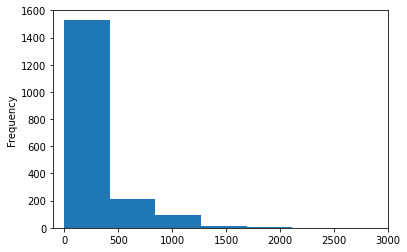

In [ ]:
#visualização com o outlier
real_estate['TimeSale'].plot(kind='hist', xlim=(-100,3000), ylim=(0 , 1600), bins = 100);

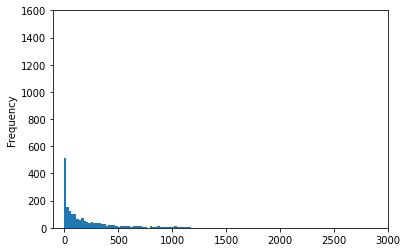

In [ ]:
#efeito de tirar o outlier
real_estate_novo['TimeSale'].plot(kind='hist', xlim=(-100,3000), ylim=(0 , 1600), bins = 100);

Para melhorar a visualização:

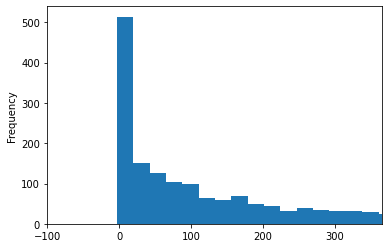

In [ ]:
#Plotando somente as propriedades vendidas em até 1 ano
real_estate_novo['TimeSale'].plot(kind='hist', xlim=(-100,365), bins = 100);

Assim, vemos que a situação mais frequente é as propriedades serem vendidas nos primeiros vinte dias após seu registro.

#### Parte 6
Podemos verificar reduções de preço se a propriedade demorar muito para ser vendida?

*dica: você pode verificar qualquer correlação entre a diferença do preço inicial e do preço vendido e o tempo desde o registro*

**Resposta:** Primeiramente, vemos na tabela a seguir que é bem raro uma propriedade ter *SaleValue* maior que *PropertyValue*.

In [ ]:
#Contando quantas propriedades tem SaleValue maior que PropertyValue (lembre que o DataFrame tem 1852 registros)
real_estate[(real_estate['PropertyValue'] - real_estate['SaleValue']) < 0]['DateSold'].count()

23

Vamos criar uma coluna com a diferença entre *PropertyValue* e *SaleValue*:

In [ ]:
#Criando coluna com a diferença entre PropertyValue e SaleValue
real_estate['DifValue'] = (real_estate['PropertyValue'] - real_estate['SaleValue'])

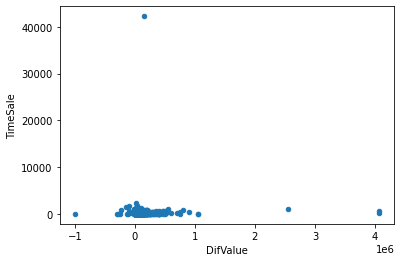

In [ ]:
#Plotando TimeSale vs. DifValue para verificar se há relação
real_estate.plot(kind='scatter', x = 'DifValue', y = 'TimeSale');

Repare que há alguns *outliers* que dificultam a visualização. Vamos removê-los:

In [ ]:
#Removendo outliers em DifValue
real_estate_novo2 = real_estate[(real_estate['TimeSale'] < 3000) & (real_estate['DifValue'] < 2000000)]

Agora sim conseguimos gerar um gráfico que nos permita analisar a questão.
A conclusão que se pode tirar visualmente do gráfico é que não há correlação entre diminuição de preço e demora para vender a propriedade.

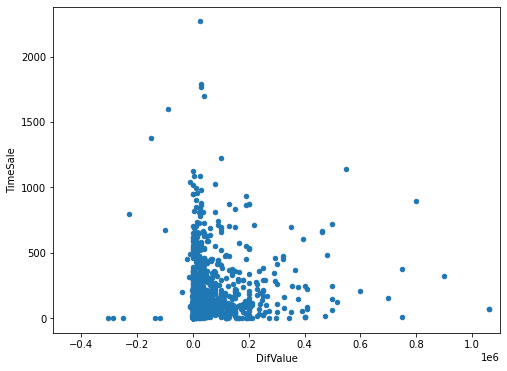

In [ ]:
real_estate_novo2.plot(kind='scatter', x = 'DifValue', y = 'TimeSale', xlim=(-500000, 1100000), figsize = (8,6));

Para confirmarmos que não há correlação, usemos a função *built-in* do Pandas:

In [ ]:
real_estate[['DifValue', 'TimeSale']].corr()

,DifValue,TimeSale
DifValue,1.000000,0.027803
TimeSale,0.027803,1.000000


Realmente, a correlação é muito próxima a zero!

<a id="pan"></a>
## 4. Data Profiling com Pandas
Uma maneira rápida e simples de analisar seu conjunto de dados é usar um pacote chamado ```pandas_profiling```.

A base deste módulo python é automatizar algumas etapas da EDA, como resumir dados, boxplot, análise de correlação, medir valores nulos e assim por diante. Tudo isso é exibido em um bom relatório, como você verá mais adiante.

As principais informações obtidas neste relatório:
* __Essenciais__: tipo, valores únicos, valores ausentes
* __Estatísticas de quantis__: valor mínimo, Q1, mediana, Q3, máximo, intervalo, intervalo interquartil
* __Estatísticas descritivas__: média, modo, desvio padrão, soma, desvio absoluto médio, coeficiente de variação, curtose, assimetria
* __Os valores mais frequentes__
* __Histograma__
* __Correlações__ destacando variáveis altamente correlacionadas, matrizes de Spearman e Pearson

In [ ]:
#Instalação do pandas_profiling 
#Caso utilize o Colab, comente a parte do notebook e retire a "#" da linha indicada

#pip install pandas-profiling[notebook] #Tradicional

!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip #---> Utilizando Colab

     - 56.3MB 667kB/s
     |████████████████████████████████| 71kB 3.5MB/s 
     |████████████████████████████████| 71kB 4.3MB/s 
     |████████████████████████████████| 604kB 22.0MB/s 
     |████████████████████████████████| 3.1MB 30.0MB/s 
     |████████████████████████████████| 71kB 6.7MB/s 
     |████████████████████████████████| 296kB 43.6MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-2.9.0-py2.py3-none-any.whl size=258952 sha256=e6d6bb989c5b9bc4acc6f99e5406dcd0754abad9d63752d112cbc20c3efdfc59
  Stored in directory: /tmp/pip-ephem-wheel-cache-z5jq11up/wheels/56/c2/dd/8d945b0443c35df7d5f62fa9e9ae105a2d8b286302b92e0109
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp36-none-any.whl size=27085 sha256=296826579e1f8cd036a96a757e86ec11d43c4957284dadbfbba734bb1a43bf9d
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
  Created wheel for imagehash: filename=ImageHash-4.1.0-py2.py3-none-any.whl size=2919

In [ ]:
import pandas_profiling as pp

profile = pp.ProfileReport(iris)
profile.to_notebook_iframe()

Finalmente, para gerar um arquivo de relatório HTML, use a função ```to_file```.

In [ ]:
profile.to_file("iris_report.html")

### Exercicio 3


Criem um relatório do perfil dos dados para a base ```real_estate```.

Explore o relatório e verifique se as análises automatizadas poderiam ter auxiliado no exercicio anterior. O Pandas Profiling é uma boa abordagem para fazer EDA?

**Resposta:** O relatório é útil para algumas análises padronizadas (descrição estatística, busca de *outliers*), mas não substitui nosso olhar humano, nossa capacidade de buscar e perceber tendências, relações e padrões.

In [ ]:
profile = pp.ProfileReport(real_estate)
profile.to_notebook_iframe()

#### Aprofundamentos
Leiam os artigos abaixo. Eles irão complementar os assuntos abordados na aula e ajudarão a entender algumas aplicações de EDA.
* [What is Exploratory Data Analysis?](https://towardsdatascience.com/exploratory-data-analysis-8fc1cb20fd15)
* [Artigo do Medium sobre EDA](https://towardsdatascience.com/exploratory-data-analysis-8fc1cb20fd15)

<a id="pan"></a>
## Fim da Primeira Parte!
Com a conclusão desta aula, esperamos que você tenha aumentado seu repertorio de técnicas para fazer uma boa EDA!
Na próxima parte iremos explorar alguns conceitos de Aprendizado não Supervisionado. Os conceitos discutidos nesta primeira etapa serão muito uteis nas analises de clusterização, portanto, certifique-se de tirar todas suas dúvidas conosco!

Até a próxima parte!!